In [1]:

import geopandas as gpd
import pandas as pd
import locale
import numpy as np
import os
import matplotlib.pyplot as plt
import matplotlib.patches as patches
from IPython.display import display, Markdown
pd.options.display.float_format = '{:.4f}'.format
pd.set_option('display.precision', 4)
locale.setlocale(locale.LC_ALL, 'pt_BR.UTF-8')
import warnings
warnings.filterwarnings('ignore')
glebas = gpd.read_file('../glebas-federais.gpkg', layer='glebas-mais-amazonia')
glebas = glebas.set_index('gid')

uf_analise = 'Acre'

# Definição de cores
cor_gleba = '#e9cf68'
cor_SIGEF = '#e0bd1f'
cor_PA = '#998115'
cor_TI = '#f2d4d3'
cor_TQ = '#d7c0dd'
cor_UC = '#99eb65'
cor_Floresta = '#a7f5e0'
cor_massa_agua = '#0751ff'
cor_rodovias = '#e10c00'
cor_gleba_flo = '#D9E3A9'
cor_gleba_uc = '#C1DC66'
cor_gleba_ti = '#EFD9A5'
cor_gleba_pa = '#C1A83E'
cor_gleba_tq = '#CDAFD4'
cor_gleba_sigef = '#E4C643'

pasta = 'sobreposicao_ac'

glebas = glebas[glebas['uf_nome']==uf_analise].sort_values('nome_gleba')
#glebas = glebas.iloc[:40]

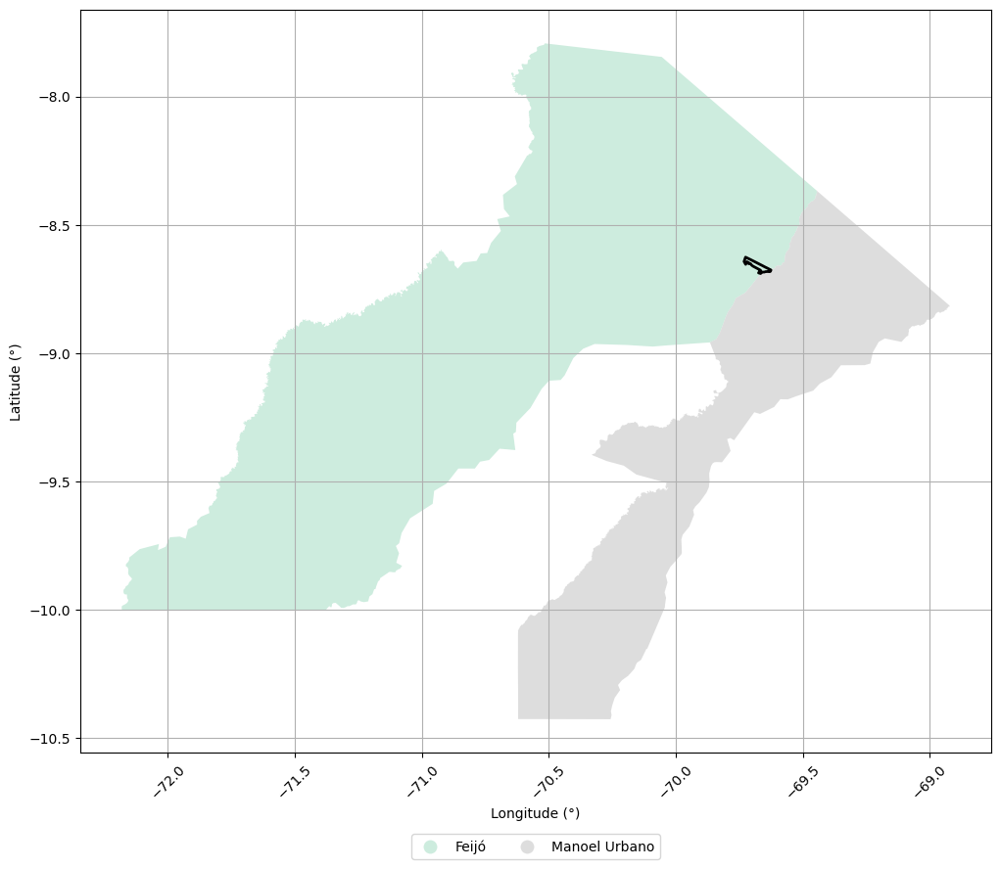

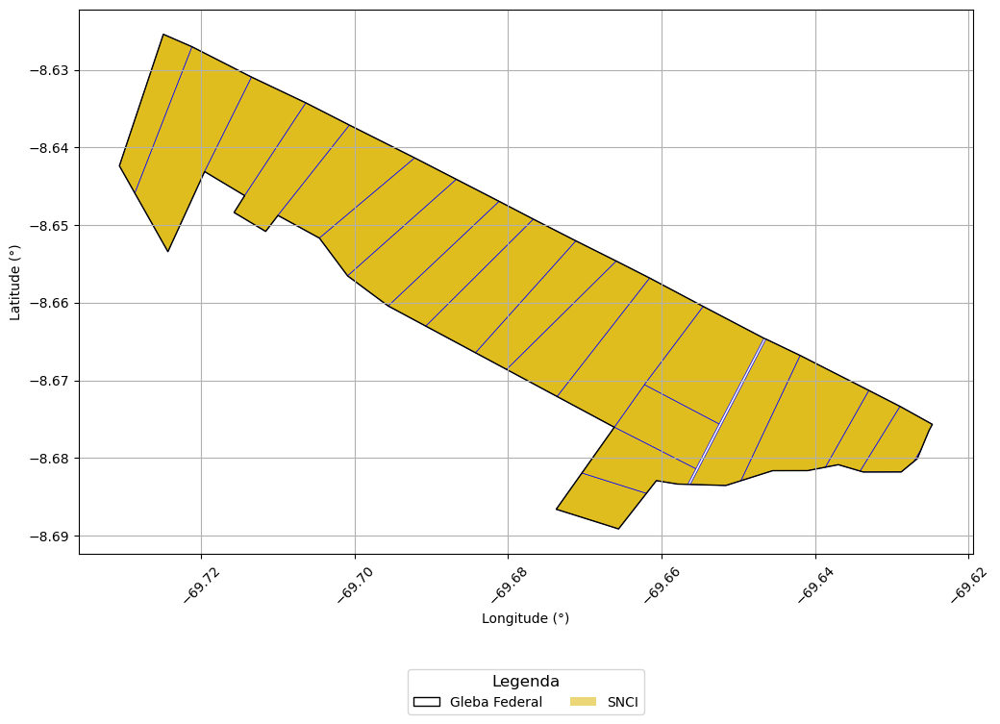

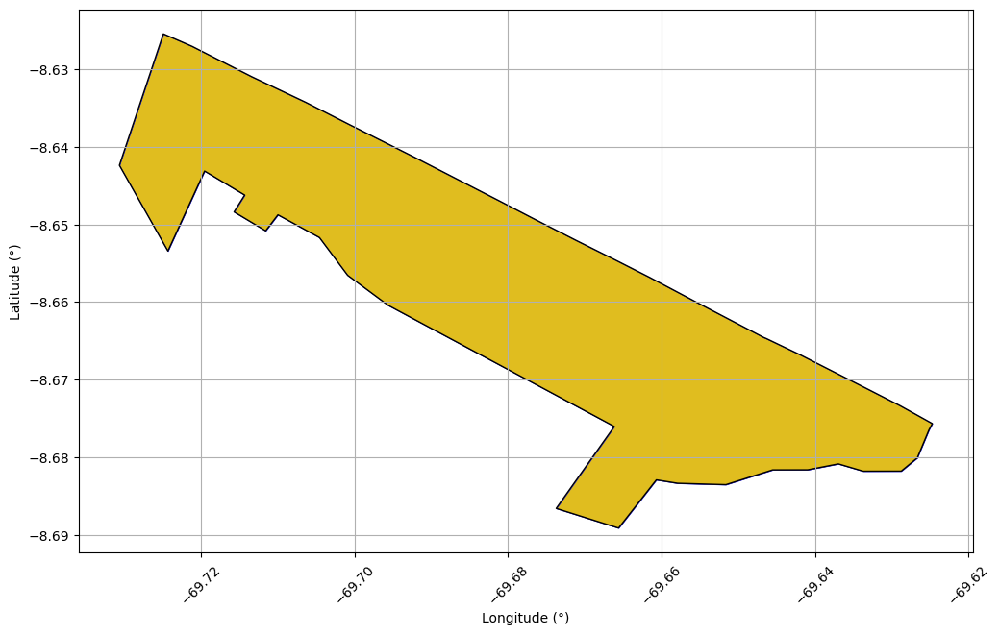

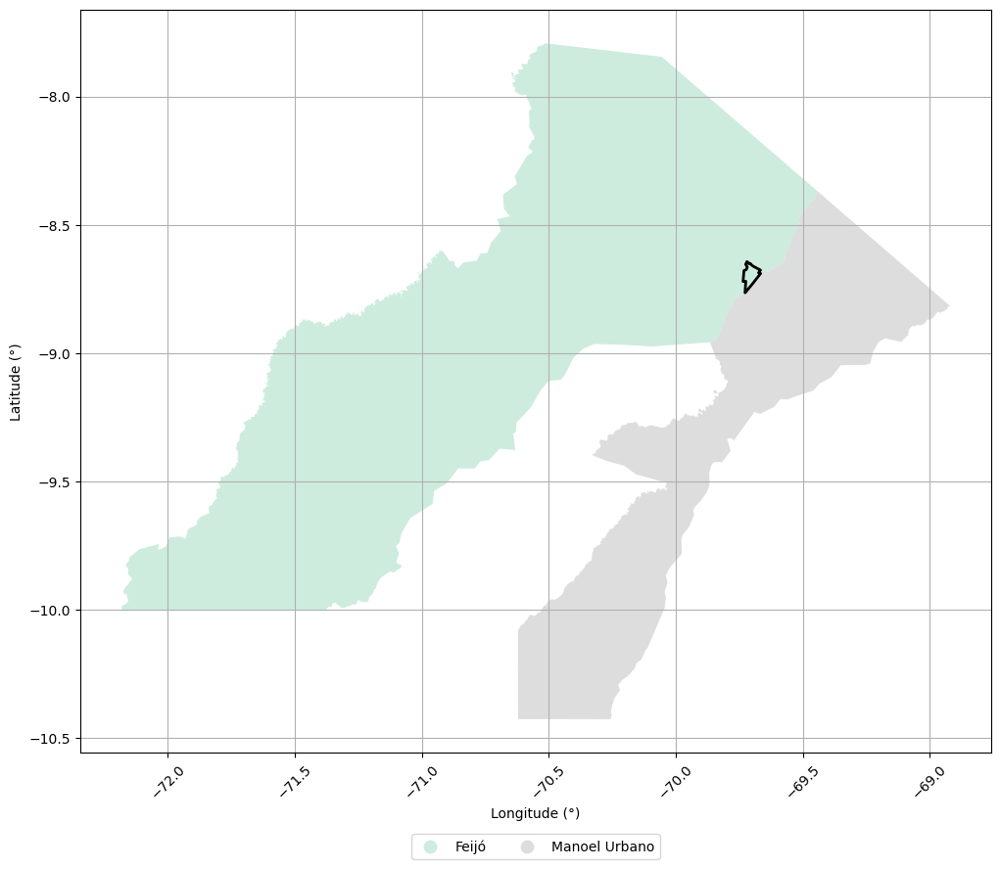

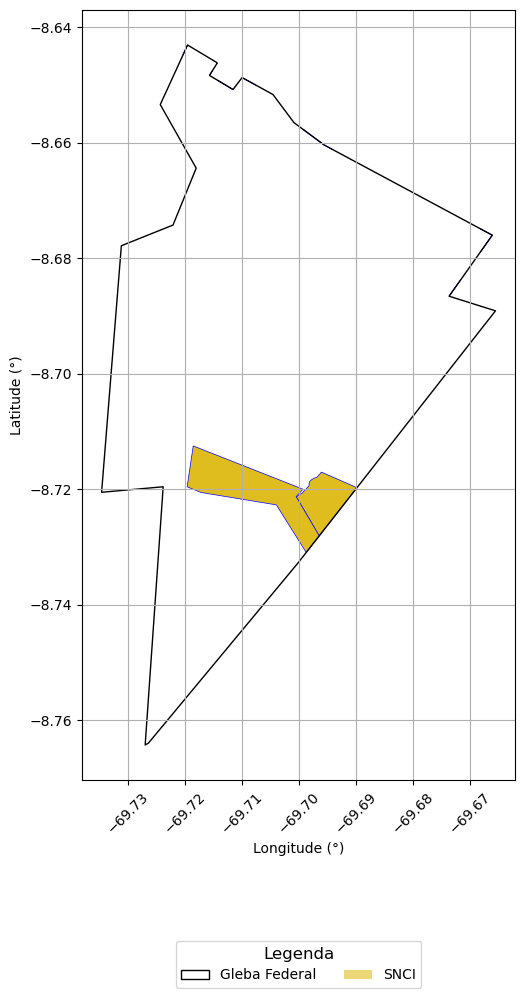

...

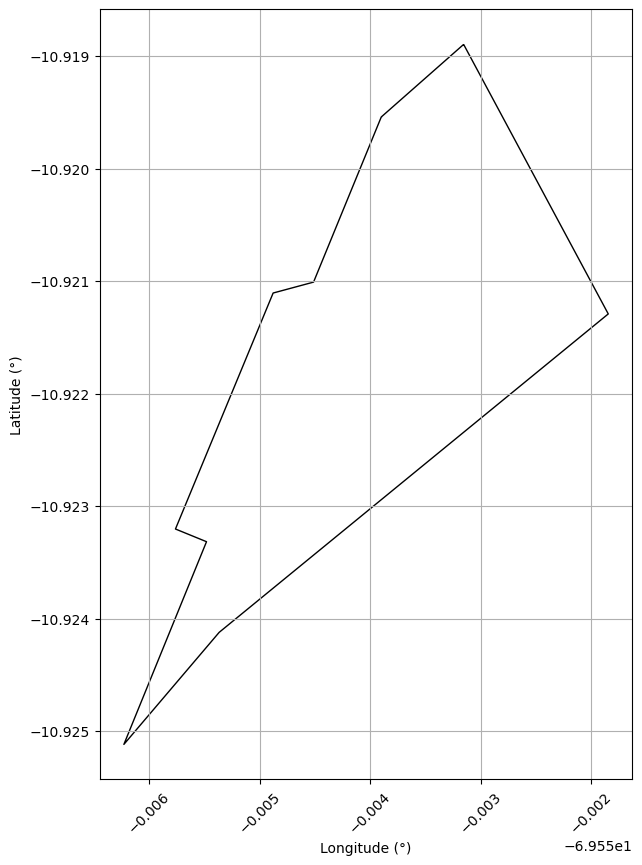

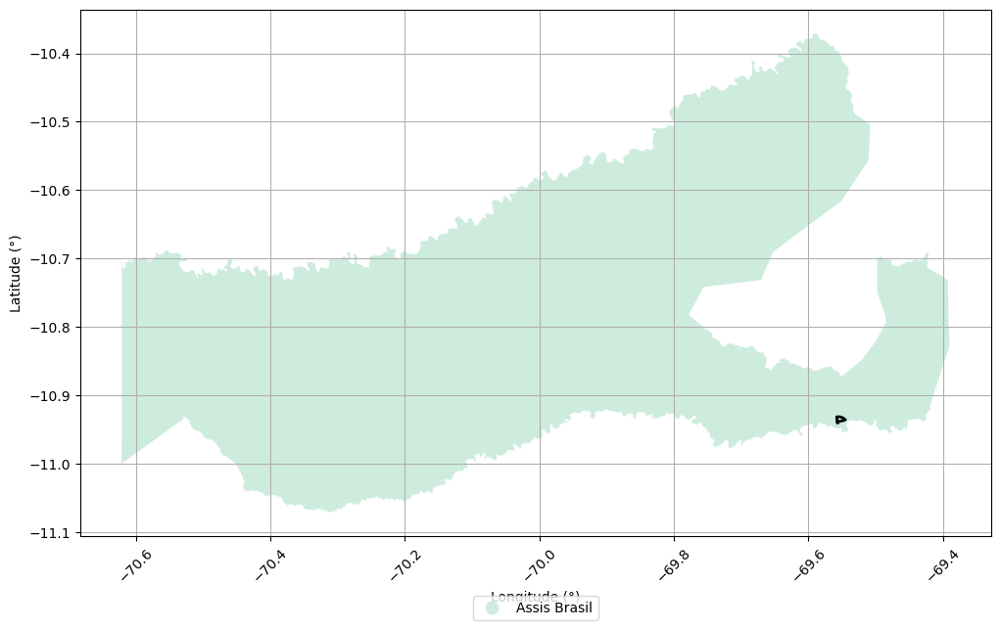

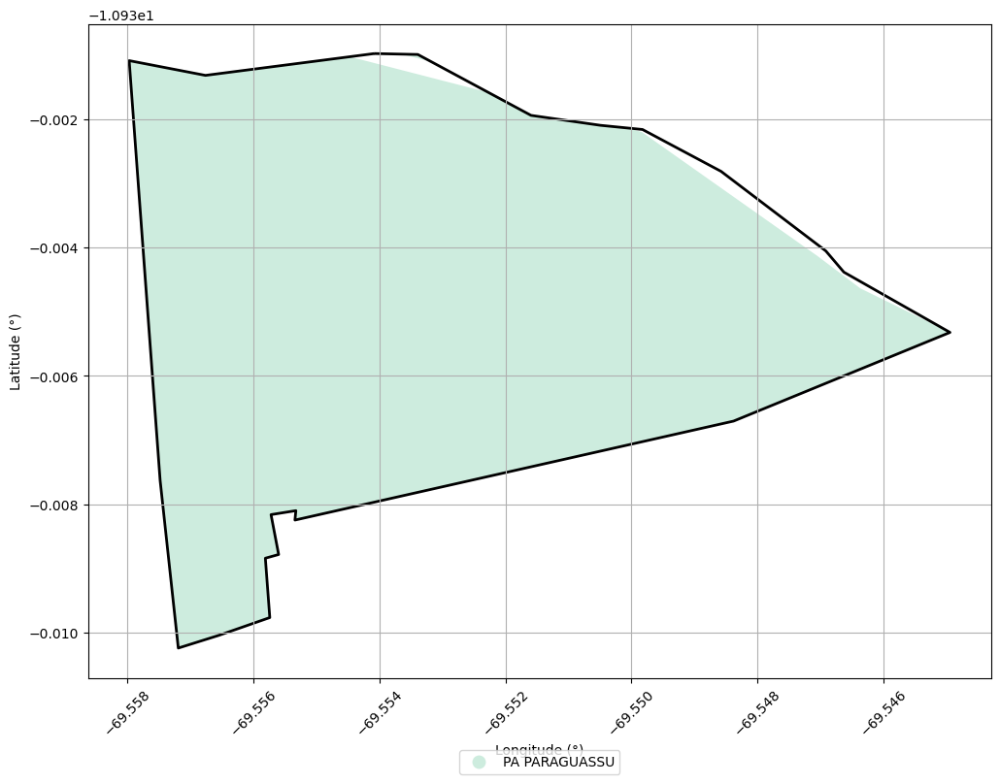

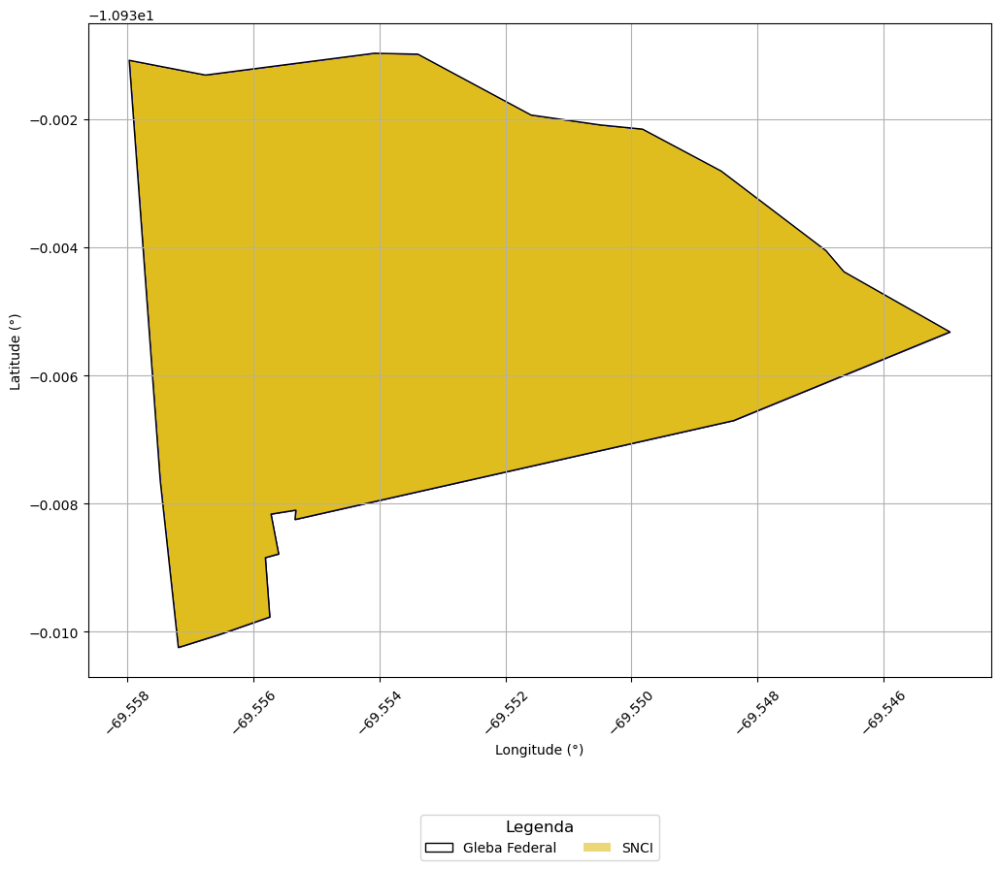

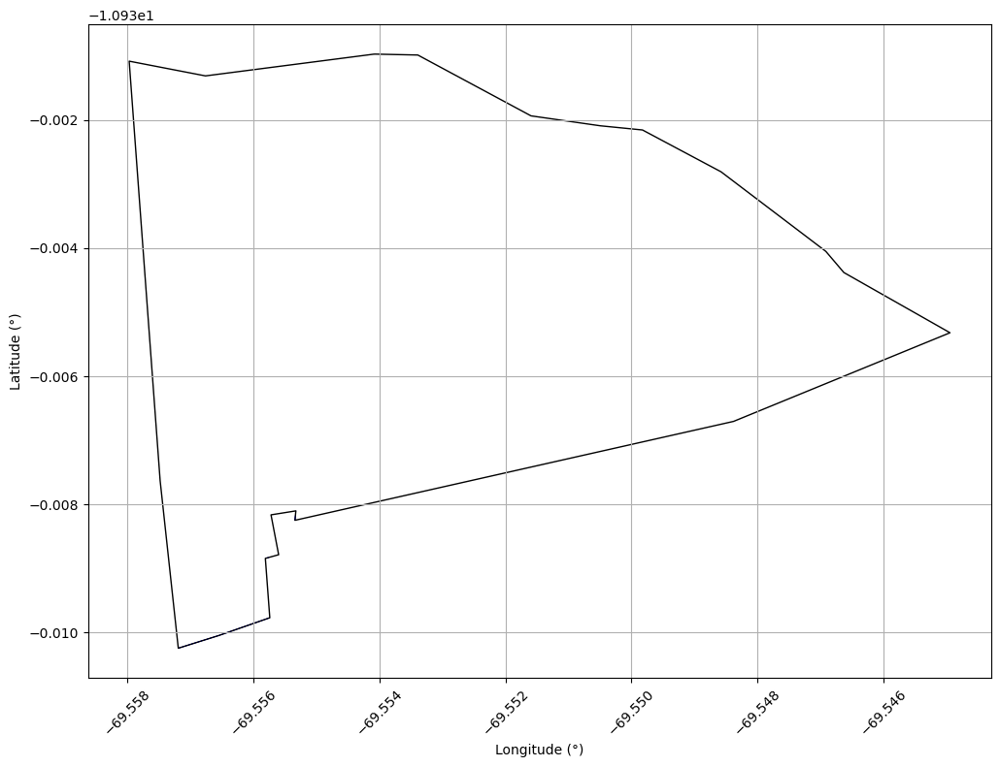

In [ ]:
for row in glebas.itertuples():
    indice = int(row.Index)
    gleba = glebas.loc[[indice]]
    nome_da_gleba = gleba["nome_gleba"].values[0]
    #display(Markdown(f'## Gleba Analisada: {nome_da_gleba}'))
    gleba = gleba.rename(columns={'nome_gleba':'Nome da Gleba',
    'area_ha':'Área (ha)'})
    gleba[['Nome da Gleba','Área (ha)']].to_csv(f'{pasta}/gleba{indice}_municipios1.csv', index=False)
    #display(Markdown('### Abrangência Municipal'))
    fig, ax = plt.subplots(figsize=(12,10))

    municipio_gleba = gpd.read_file('../municipios-glebas.gpkg', 
                                    layer=f'{indice}')
    municipio_gleba.plot(ax=ax, column='Nome do Município', categorical=True,
                         legend=True,
                         alpha=0.65, cmap='Pastel2',
                         legend_kwds={'loc': 'upper center',
                         'bbox_to_anchor':(0.5,-0.15),'ncols':3})
    gleba.plot(ax=ax, facecolor='none', edgecolor='black', linewidth=2)
    plt.xlabel('Longitude (°)')
    plt.ylabel('Latitude (°)')
    plt.xticks(rotation=45)
    plt.grid()
    fig.savefig(f'{pasta}/gleba{indice}_municipios.png', dpi=300)
    municipio_gleba[['Código da UF', 'Estado', 'UF', 
    'Código do Município', 'Nome do Município']].to_csv(f'{pasta}/gleba{indice}_municipios.csv',index=False)

    #display(Markdown('### Unidades de Conservação'))

    try:
        uc_gleba = gpd.read_file('../uc-glebas.gpkg', 
                                        layer=f'{indice}')
        fig_uc, ax_uc = plt.subplots(figsize=(12,10))
        uc_gleba.plot(ax=ax_uc, column='Nome', categorical=True,
                        legend=True,
                        alpha=0.65, cmap='Pastel2',
                        legend_kwds={'loc': 'upper center',
                        'bbox_to_anchor':(0.5,-0.15),'ncols':3})
        gleba.plot(ax=ax_uc, facecolor='none', edgecolor='black', linewidth=2)
        plt.xlabel('Longitude (°)')
        plt.ylabel('Latitude (°)')
        plt.xticks(rotation=45)
        plt.grid()
        plt.savefig(f'{pasta}/gleba{indice}_uc.jpg', dpi=300)

        uc_gleba[['Nome','Categoria','Responsabilidade',
        'Área Sobreposta (ha)']].to_csv(f'{pasta}/gleba{indice}_uc.csv',index=False)

    except:
        pass
        
    try:
        ti_gleba = gpd.read_file('../ti-glebas.gpkg', 
                                layer=f'{indice}')
        fig_ti, ax_ti = plt.subplots(figsize=(12,10))
        ti_gleba.plot(ax=ax_ti, column='terrai_nom', categorical=True,
                        legend=True,
                        alpha=0.65, cmap='Pastel2',
                        legend_kwds={'loc': 'upper center',
                        'bbox_to_anchor':(0.5,-0.15),'ncols':3})
        gleba.plot(ax=ax_ti, facecolor='none', edgecolor='black', linewidth=2)
        plt.xlabel('Longitude (°)')
        plt.ylabel('Latitude (°)')
        plt.xticks(rotation=45)
        plt.grid()
        plt.savefig(f'{pasta}/gleba{indice}_ti.jpg', dpi=300)


        ti_gleba[['Nome', 'Fase de Regularização',
                        'Área Sobreposta (ha)']].to_csv(f'{pasta}/gleba{indice}_ti.csv',index=False)

    except:

        pass


    try:
        pa_gleba = gpd.read_file('../pa-glebas.gpkg', 
                            layer=f'{indice}')
        fig_pa, ax_pa = plt.subplots(figsize=(12,10))
        pa_gleba.plot(ax=ax_pa, column='Nome', categorical=True,
                        legend=True,
                        alpha=0.65, cmap='Pastel2',
                        legend_kwds={'loc': 'upper center',
                        'bbox_to_anchor':(0.5,-0.1),'ncols':3})
        gleba.plot(ax=ax_pa, facecolor='none', edgecolor='black', linewidth=2)
        plt.xlabel('Longitude (°)')
        plt.ylabel('Latitude (°)')
        plt.xticks(rotation=45)
        plt.grid()
        plt.savefig(f'{pasta}/gleba{indice}_pa.jpg', dpi=300)

        pa_gleba[['SIPRA','Nome','Município',
                'Área Sobreposta (ha)']].to_csv(f'{pasta}/gleba{indice}_pa.csv', index=False)

    except:

        pass



    try:
        tq_gleba = gpd.read_file('../tq-glebas.gpkg', 
                        layer=f'{indice}')
        fig_tq, ax_tq = plt.subplots(figsize=(12,10))
        tq_gleba.plot(ax=ax_tq, column='nm_comunid', categorical=True,
                        legend=True, alpha=0.65, cmap='Pastel2',
                        legend_kwds={'loc': 'upper center',
                        'bbox_to_anchor':(0.5,-0.1),'ncols':3})
        gleba.plot(ax=ax_tq, facecolor='none', edgecolor='black', linewidth=2)
        plt.xlabel('Longitude (°)')
        plt.ylabel('Latitude (°)')
        plt.xticks(rotation=45)
        plt.grid()
        plt.savefig(f'{pasta}/gleba{indice}_tq.jpg', dpi=300)

        tq_gleba[['Nome', 'Responsabilidade', 'Fase da Regularização',
                    'Área Sobreposta (ha)']].to_csv(f'{pasta}/gleba{indice}_tq.csv', index=False)

    except:

        pass


    try:
        sigef_gleba = gpd.read_file('../sigef-glebas.gpkg', 
                        layer=f'{indice}')
        fig_sigef, ax_sigef = plt.subplots(figsize=(12,10))
        sigef_gleba.plot(ax=ax_sigef, facecolor=cor_SIGEF, edgecolor='blue', linewidth=0.5)
        gleba.plot(ax=ax_sigef, facecolor='none', edgecolor='black',
                    linewidth=1)
        # LEGENDAS
        patch_list = []
        patch_list.append(patches.Patch(facecolor='none', edgecolor='black',
                        label='Gleba Federal', linewidth=1))
        patch_list.append(patches.Patch(facecolor=cor_SIGEF, alpha=0.6, 
                            edgecolor='none', label='SIGEF', linewidth=1))
        # Creates a legend with the list of patches above.
        ax_sigef.legend(handles=patch_list, fontsize=10, loc='upper center',
                bbox_to_anchor = (0.5 , -0.2), ncols=3,title='Legenda', title_fontsize=12)
        plt.xlabel('Longitude (°)')
        plt.ylabel('Latitude (°)')
        plt.xticks(rotation=45)
        plt.grid()
        plt.savefig(f'{pasta}/gleba{indice}_sigef.jpg', dpi=300)


        sigef_gleba[['Código SIGEF','Natureza do Polígono', 
                             'Área Sobreposta (ha)']].sort_values('Natureza do Polígono').to_csv(
                                 f'{pasta}/gleba{indice}_sigef.csv', index=False)

    except:

        pass
    


    try:
        snci_gleba = gpd.read_file('../snci-glebas.gpkg', layer=f'{indice}')
        fig_snci, ax_snci = plt.subplots(figsize=(12,10))
        snci_gleba.plot(ax=ax_snci, facecolor=cor_SIGEF, edgecolor='blue', linewidth=0.5)
        gleba.plot(ax=ax_snci, facecolor='none', edgecolor='black',
                    linewidth=1)
        # LEGENDAS
        patch_list = []
        patch_list.append(patches.Patch(facecolor='none', edgecolor='black',
                        label='Gleba Federal', linewidth=1))
        patch_list.append(patches.Patch(facecolor=cor_SIGEF, alpha=0.6, 
                            edgecolor='none', label='SNCI', linewidth=1))
        # Creates a legend with the list of patches above.
        ax_sigef.legend(handles=patch_list, fontsize=10, loc='upper center',
                bbox_to_anchor = (0.5 , -0.2), ncols=3,title='Legenda', title_fontsize=12)
        plt.xlabel('Longitude (°)')
        plt.ylabel('Latitude (°)')
        plt.xticks(rotation=45)
        plt.grid()
        plt.savefig(f'{pasta}/gleba{indice}_snci.jpg', dpi=300)
        snci_gleba = snci_gleba.rename(columns={
            'num_certif':'Código SNCI'
        })
        snci_gleba[['Código SNCI', 'Área Sobreposta (ha)']].to_csv(f'{pasta}/gleba{indice}_snci.csv', index=False)

    except:

        pass

